In [1]:
%env ALL_PROXY=http://192.168.12.100:7890
%env HTTP_PROXY=http://192.168.12.100:7890
%env HTTPS_PROXY=http://192.168.12.100:7890
import stt as st
import scanpy as sc
import cellrank as cr
import scvelo as scv
adata = scv.datasets.bonemarrow()

env: ALL_PROXY=http://192.168.12.100:7890
env: HTTP_PROXY=http://192.168.12.100:7890
env: HTTPS_PROXY=http://192.168.12.100:7890


In [2]:
scv.pp.filter_and_normalize(adata, min_shared_counts=30, n_top_genes=2000)
scv.pp.moments(adata)

Filtered out 8380 genes that are detected 30 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.


/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/pyemma/__init__.py:92: UserWarning: You are not using the latest release of PyEMMA. Latest is 2.5.7, you have 2.5.6.
  .format(latest=latest, current=current), category=UserWarning)


computing neighbors
    finished (0:00:02) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [3]:
adata

AnnData object with n_obs × n_vars = 5780 × 2000
    obs: 'clusters', 'palantir_pseudotime', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts'
    var: 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable'
    uns: 'clusters_colors', 'pca', 'neighbors'
    obsm: 'X_tsne', 'X_pca'
    varm: 'PCs'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu'
    obsp: 'distances', 'connectivities'

In [4]:
adata.obs['attractor']=adata.obs['clusters']
adata_aggr = st.tl.dynamical_iteration(adata,n_states =7, n_iter = 20, n_neighbors = 60, n_components = 21, weight_connectivities=0.5, monitor_mode=False)

Mat Object: 1 MPI processes
  type: seqdense
1.0000000000000011e+00 5.8559850657722203e-03 1.0417594290408902e-02 6.7618288889682273e-03 -1.3294343445709358e-02 -4.3600287451123258e-02 -2.1556248509426658e-03 -5.5520793233436298e-04 2.3120604863548239e-02 4.7614203020664950e-02 3.6031924676036255e-02 5.7203907435489608e-03 -2.9170135916933609e-02 5.7491047790331824e-02 5.1543954440343162e-03 -4.5643016455217409e-03 1.7584158647808299e-02 -4.2201009511459366e-02 3.6672340200344239e-02 4.3179878388763339e-02 1.1146018257710557e-02 
0.0000000000000000e+00 9.7347787244057626e-01 -8.2906841177860435e-04 -5.9373692821204152e-03 2.6047679508130329e-03 7.8874783850793016e-03 -3.4786291330106044e-02 3.1862206476138827e-02 -3.2060662474008142e-02 7.4491872326092223e-02 3.2394024895620974e-02 5.4128006296987989e-02 -3.3388988962354421e-03 7.7520965624916796e-02 -3.7908275249408256e-02 2.0236216161460936e-02 4.0232179611578767e-02 1.1457847568851645e-02 -7.6625153204103328e-03 -3.3480956342808413e

/home/bingsanyu/1WORK/cwj/STT-release/example_notebooks/stt/tl/_dynamical_analysis.py:373: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  sc_object_aggr.obs['entropy'] = adata.obs['entropy'].values


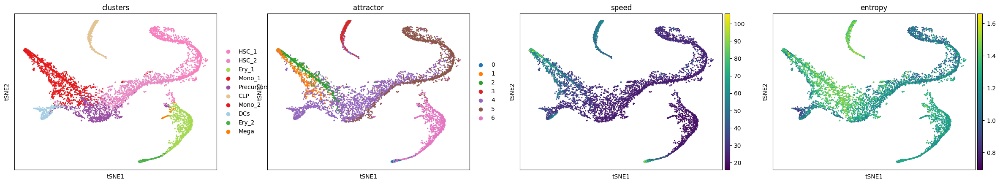

In [5]:

sc.pl.embedding(adata,color = ['clusters','attractor','speed','entropy'],basis = 'tsne')


In [6]:
adata_aggr.obsm['X_tsne'] = adata.obsm['X_tsne']
scv.tl.velocity_graph(adata_aggr,n_jobs=-1,vkey = 'vj')

computing velocity graph (using 16/16 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:38) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)


In [7]:
st.tl.construct_landscape(adata,thresh_cal_cov = 0.5,scale_land = 0.9,scale_axis = 1, N_grid = 500, coord_key = 'X_tsne')

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/sklearn/mixture/_base.py:269: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  % (init + 1), ConvergenceWarning)


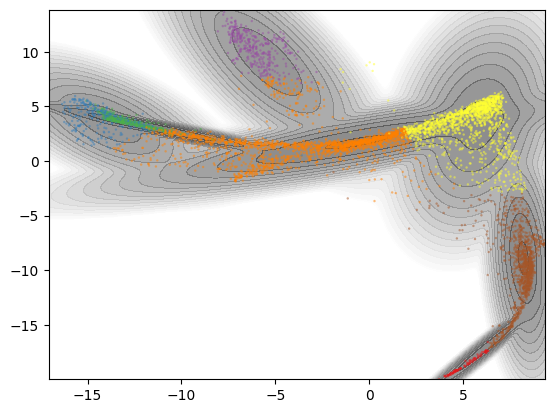

In [8]:
st.pl.plot_landscape(adata,dim=2)

In [9]:
sc.pl.embedding(adata,color = ['clusters','attractor','speed','entropy'],basis = 'trans_coord')

KeyError: "Could not find 'trans_coord' or 'X_trans_coord' in .obsm"

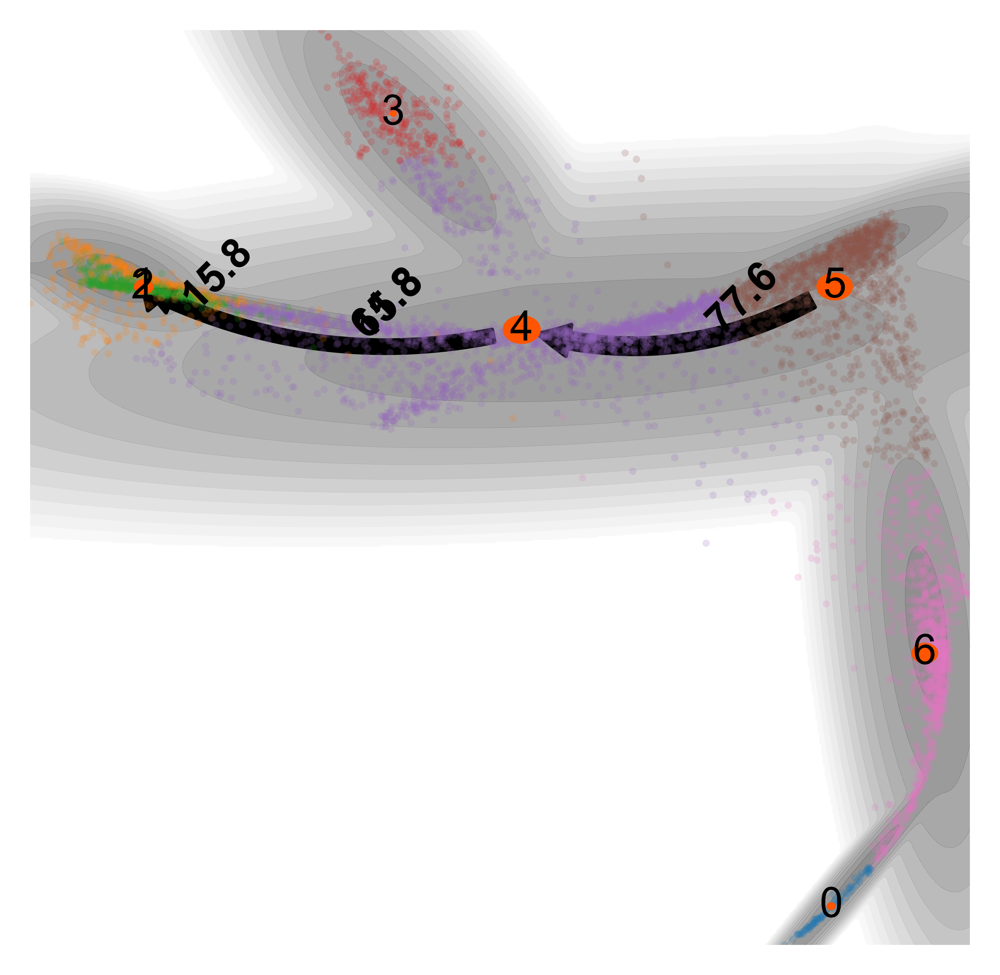

In [30]:
st.pl.infer_lineage(adata, si =5, sf = 2, method ='MPPT', size_text= 10, alpha_point = 0.2, color_palette_name = 'tab10', flux_fraction = 0.7)

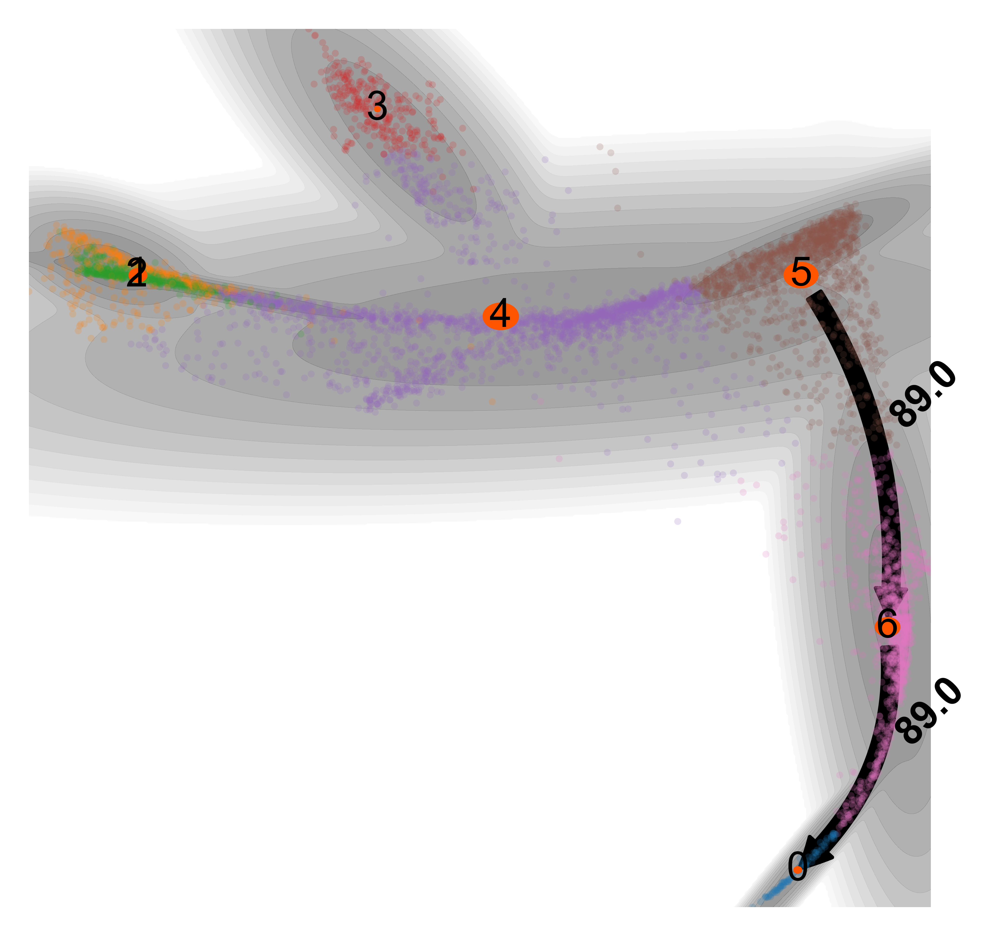

In [31]:
st.pl.infer_lineage(adata, si =5, sf = 0, method ='MPPT', size_text= 10, alpha_point = 0.2, color_palette_name = 'tab10', flux_fraction = 0.7)

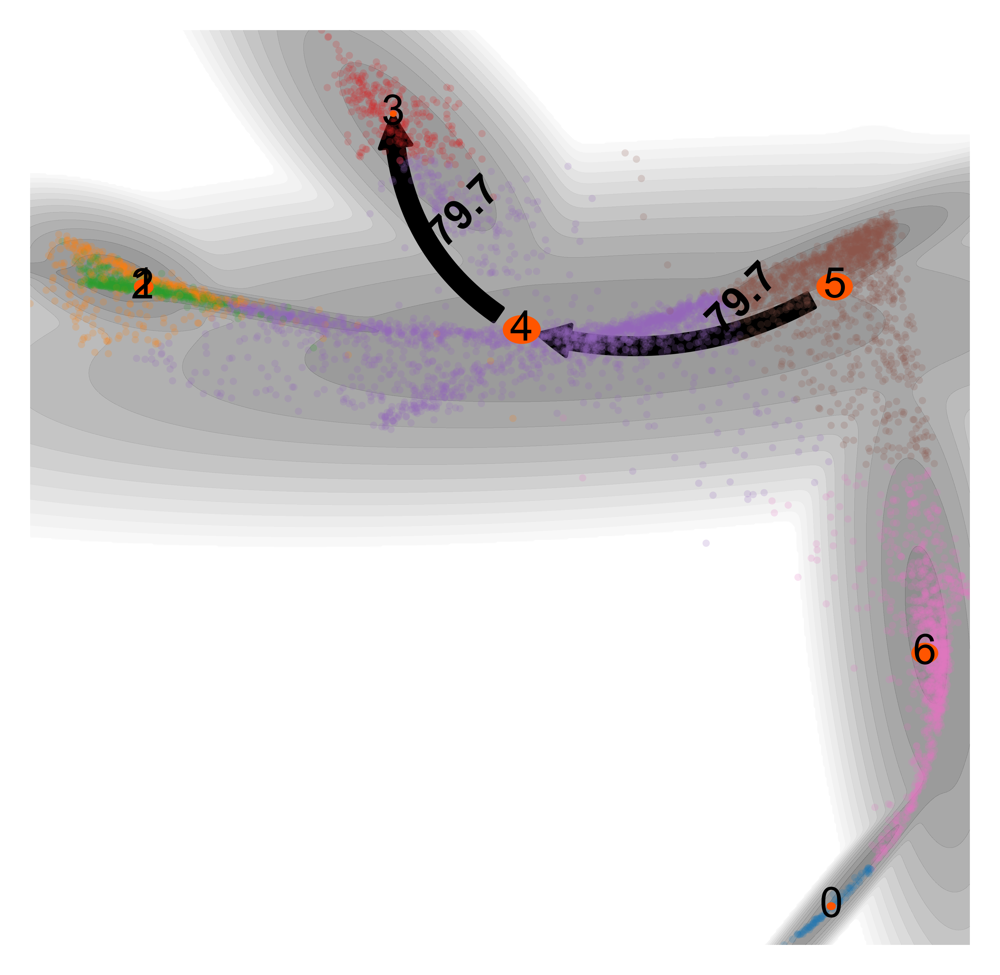

In [32]:
st.pl.infer_lineage(adata, si =5, sf = 3, method ='MPPT', size_text= 10, alpha_point = 0.2, color_palette_name = 'tab10', flux_fraction = 0.7)

In [9]:
adata.obsm['X_trans_coord']=adata.uns['land_out']['trans_coord']

In [10]:
adata_aggr.obsm['X_trans_coord']=adata.obsm['X_trans_coord']

computing velocity embedding
    finished (0:00:00) --> added
    'vj_tsne', embedded velocity vectors (adata.obsm)


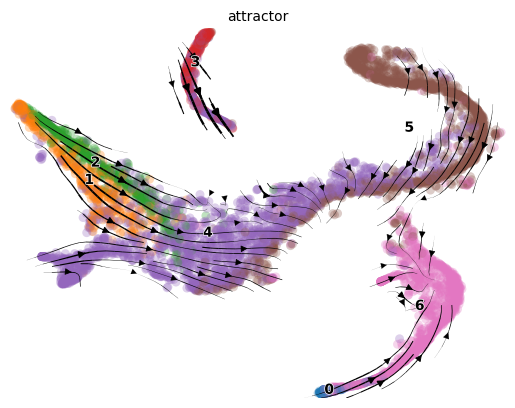

In [11]:
scv.pl.velocity_embedding_stream(adata_aggr, basis='tsne', color='attractor',vkey = 'vj',density = 2)

computing velocity embedding
    finished (0:00:00) --> added
    'vj_trans_coord', embedded velocity vectors (adata.obsm)


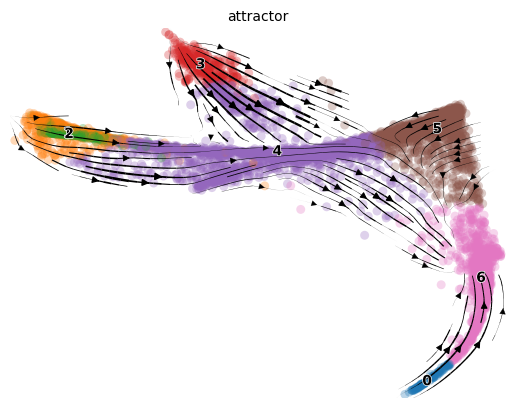

In [12]:
scv.pl.velocity_embedding_stream(adata_aggr, basis='trans_coord', color='attractor',vkey = 'vj',density = 2)

In [13]:
import matplotlib.pyplot as plt
sc.set_figure_params(dpi=600,fontsize = 10)
adata_aggr.obsm['X_trans_coord_aggr']=adata.obsm['X_trans_coord']
adata.obsm['X_trans_coord_aggr']=adata.obsm['X_trans_coord']
st.pl.plot_tensor(adata, adata_aggr, list_attractor = [2,3,6],basis = 'trans_coord',filter_cells = True, member_thresh = 0.1, density = 1)
plt.savefig('bm_tensor.png')

check that the input includes aggregated object
computing velocity graph (using 8/8 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished (0:00:23) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_trans_coord', embedded velocity vectors (adata.obsm)
check that the input includes aggregated object
computing velocity graph (using 8/8 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished (0:00:23) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_trans_coord', embedded velocity vectors (adata.obsm)
check that the input includes aggregated object
computing velocity graph (using 8/8 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: /Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished (0:00:23) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_trans_coord', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: /Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:14) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vs_trans_coord_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:10) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vs_trans_coord_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:14) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vs_trans_coord_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple MacOS to find memory corruption errors
[0]PETSC ERROR: /Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:10) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vu_trans_coord_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: /Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:10) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vu_trans_coord_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: /Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:12) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vu_trans_coord_aggr', embedded velocity vectors (adata.obsm)


  0%|          | 0/200 [00:00<?, ?sim/s]

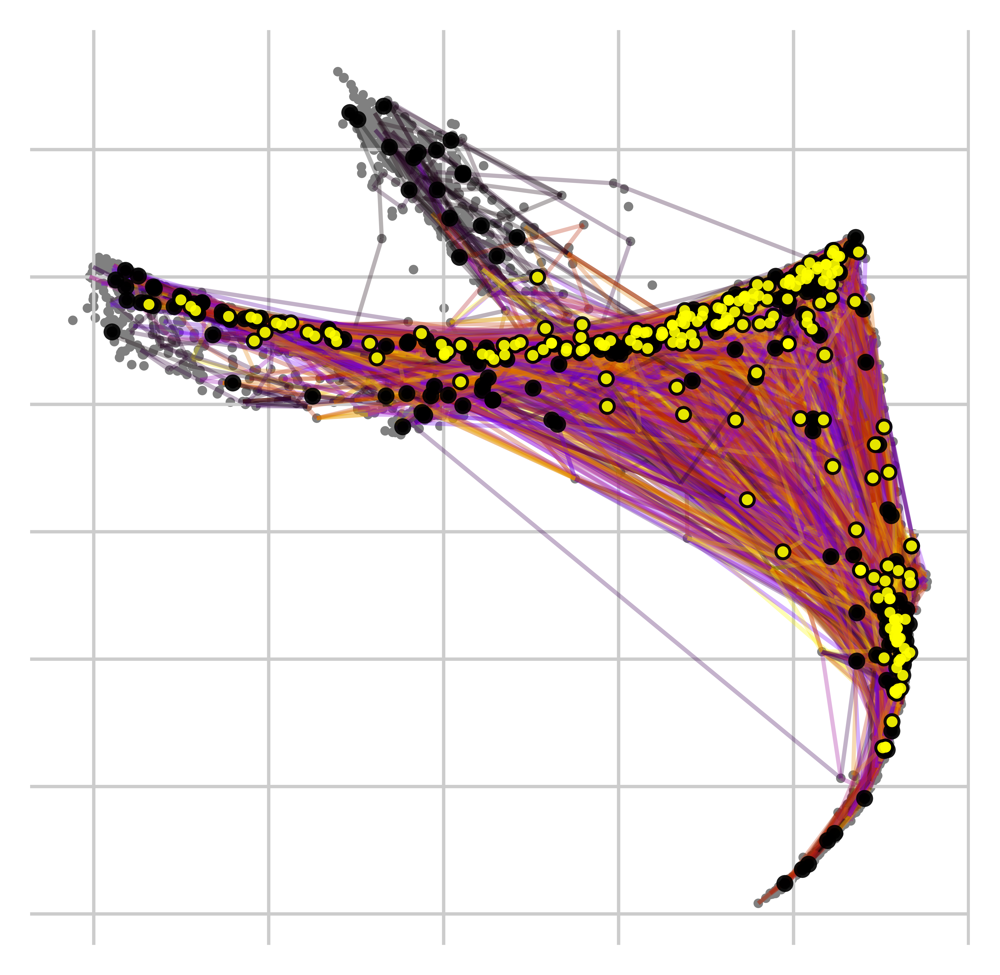

In [16]:
kernel = adata.uns['kernel']
kernel.adata.obsm['X_trans_coord'] = adata_aggr.obsm['X_trans_coord']
kernel.plot_random_walks(n_sims=200,basis='trans_coord',max_iter=200,n_jobs=-1)

In [ ]:
g = cr.tl.estimators.GPCCA(kernel)
g.fit(cluster_key="attractor",n_lineages = 7)

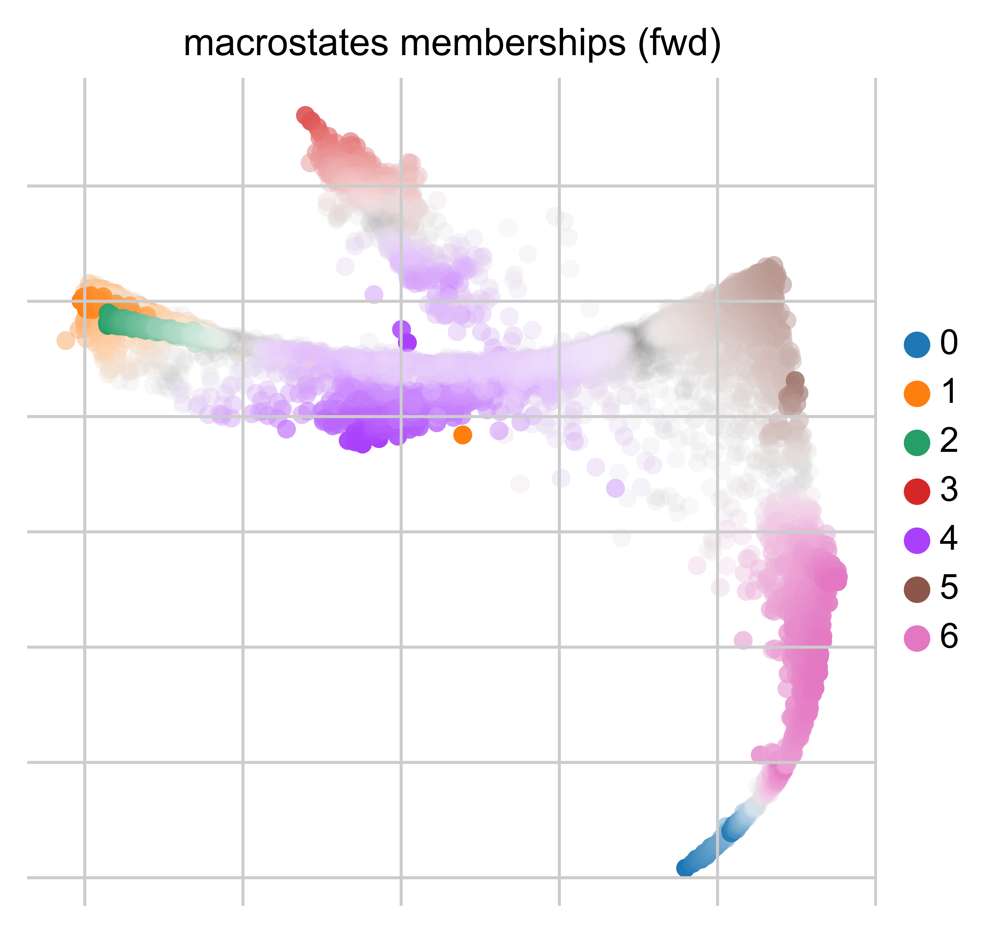

In [19]:
g.plot_macrostates(which="terminal", legend_loc="right", size=100,basis = 'trans_coord')

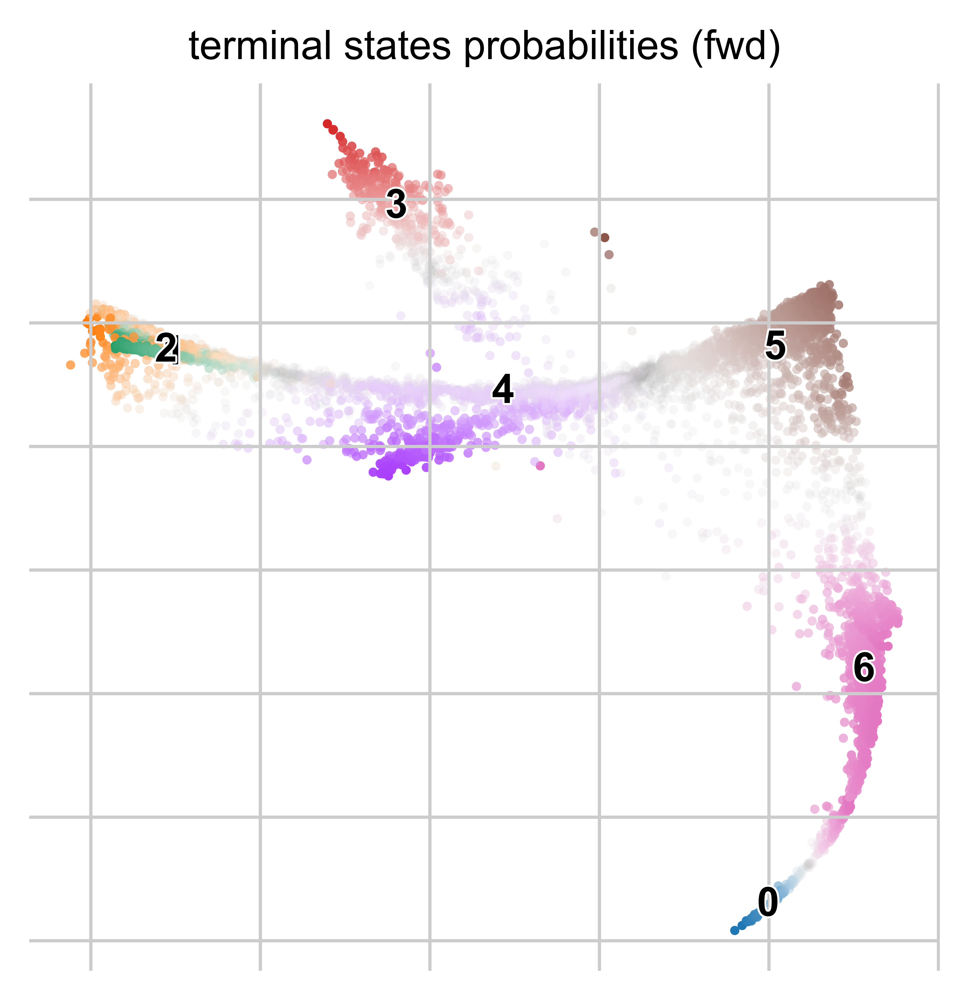

In [20]:
g.compute_terminal_states(method="top_n", n_states=7)
g.plot_terminal_states(basis='trans_coord')

In [21]:
g.compute_absorption_probabilities()

  0%|          | 0/210 [00:00<?, ?/s]

[0]PETSC ERROR: ------------------------------------------------------------------------


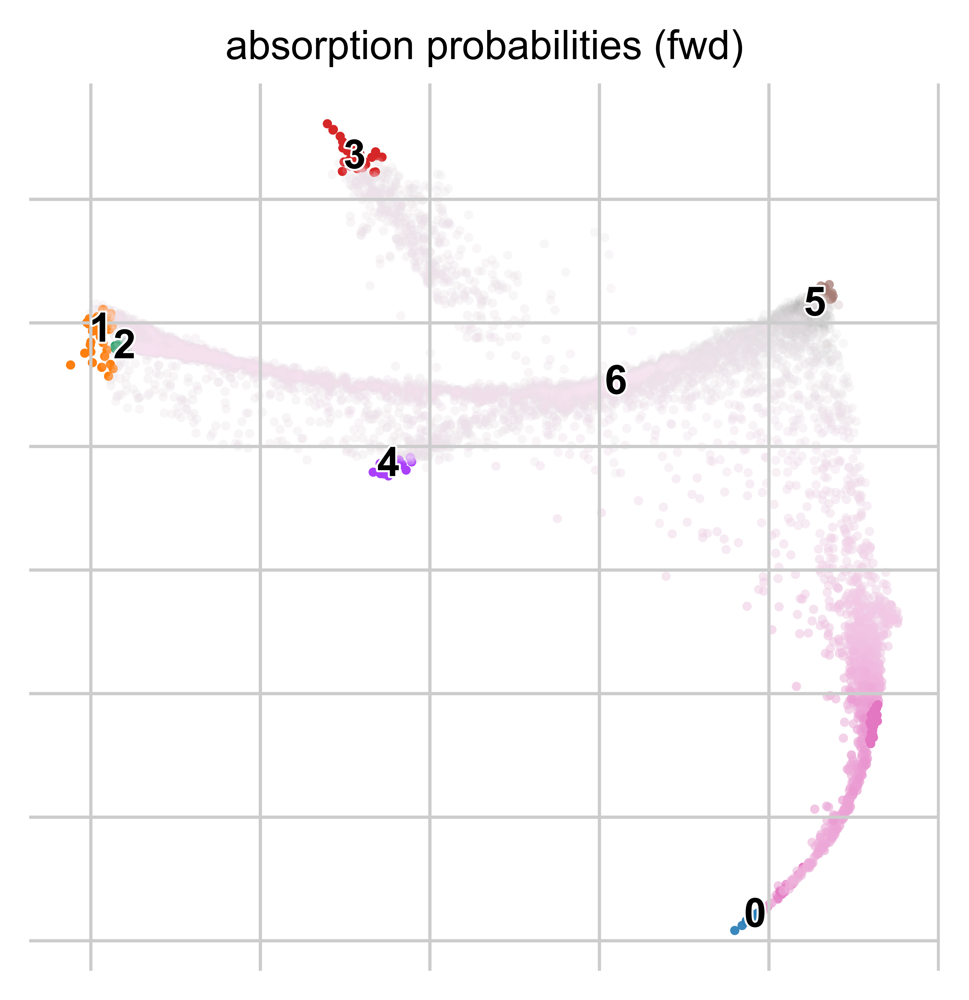

In [22]:
g.plot_absorption_probabilities(same_plot=True, basis = 'trans_coord')

In [23]:
del adata.uns['r2_keep_train']
del adata.uns['r2_keep_test']
del adata.uns['kernel_connectivities']
del adata.uns['kernel']
adata.write('bm_results.h5ad')
adata_aggr.write('bm_results_aggr.h5ad')

In [ ]:
adata = sc.read_h5ad('bm_results.h5ad')
adata_aggr = sc.read_h5ad('bm_aggr.h5ad')